## Setup

In [1]:
# Base libraries
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
# NetworkX
import networkx as nx
import osmnx as ox
# OS environment setup
from local_directories import *

In [2]:
# Reset random seeds
random_seed = 2674
# Other
neighbourhood_min_nodes = 8
max_distance = 500

## Load data

In [3]:
# Load Leciester's graph
leicester_osmnx_graph = ox.io.load_graphml(bulk_storage_directory + "/osmnx/raw_excluded/leicester-1864.graphml")
leicester_osmnx_graph_prj = ox.project_graph(leicester_osmnx_graph)

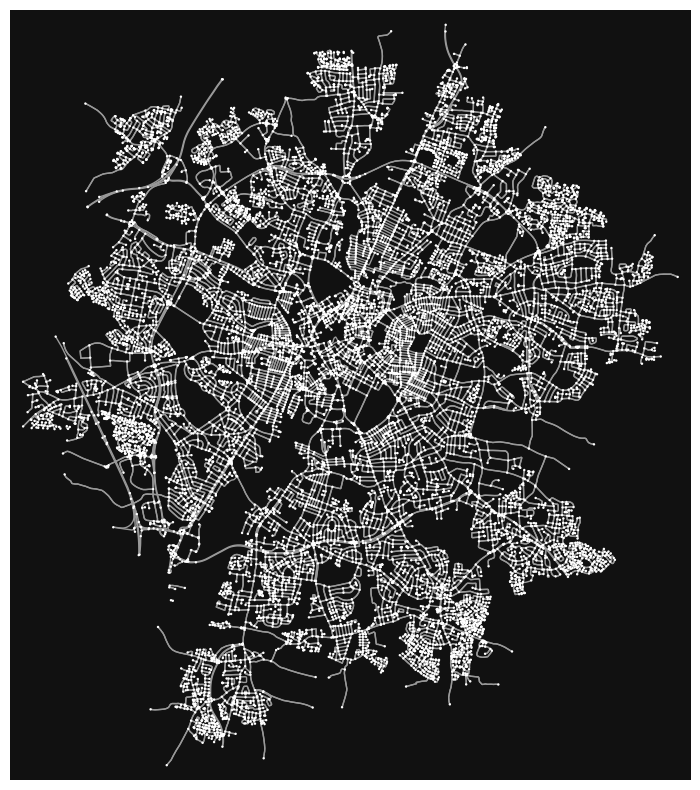

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [4]:
ox.plot_graph(
    leicester_osmnx_graph_prj,
    node_size=3,
    figsize=(10, 10))

In [5]:
# Convert graph to dataframe version
leicester_osmnx_graph_prj_df = None
for node in leicester_osmnx_graph_prj:
    node_dict = leicester_osmnx_graph_prj.nodes[node]
    node_dict["osmnx_node_id"] = int(node)
    # node_dict["osmnx_node_id"] = str(node)
    if leicester_osmnx_graph_prj_df is None:
        leicester_osmnx_graph_prj_df = pd.DataFrame.from_dict([node_dict])
    else:
        leicester_osmnx_graph_prj_df = pd.concat([leicester_osmnx_graph_prj_df, pd.DataFrame.from_dict([node_dict])])
leicester_osmnx_graph_prj_df.head()

,y,x,street_count,elevation,elevation_aster,elevation_srtm,lon,lat,osmnx_node_id,ref,highway
0,5.829804e+06,622151.977595,3,72.0,35,72,-1.196195,52.604506,194739,NaN,NaN
0,5.829991e+06,622098.041002,3,72.0,45,72,-1.196922,52.606196,1551014281,NaN,NaN
0,5.828827e+06,622259.813792,2,79.0,57,79,-1.194965,52.595696,326312,21,motorway_junction
0,5.830107e+06,622077.742140,3,79.0,43,79,-1.197179,52.607245,326320,21,motorway_junction
0,5.829673e+06,622220.645785,3,74.0,35,74,-1.195230,52.603314,2627867454,NaN,NaN


In [6]:
# Load Leciester's base stats
leicester_osmnx_basic_stats = pd.read_csv(this_repo_directory + "/data/leicester-1864_basic_stats_dist500.csv")
leicester_osmnx_basic_stats = leicester_osmnx_basic_stats.rename(columns={"node_id":"osmnx_node_id"})
# Drop NAs created when ego-graph has less than 8 nodes
leicester_osmnx_basic_stats = leicester_osmnx_basic_stats.dropna(subset=["osmnx_node_id"])
leicester_osmnx_basic_stats.head()

,0,n,m,k_avg,edge_length_total,edge_length_avg,streets_per_node_avg,streets_per_node_counts,streets_per_node_proportions,intersection_count,street_length_total,street_segment_count,street_length_avg,circuity_avg,self_loop_proportion,osmnx_node_id
7,NaN,11.0,11.0,2.0,1261.861,114.714636,3.0,"{0: 0, 1: 0, 2: 0, 3: 11}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",11.0,1261.861,11.0,114.714636,1.038343,0.0,337976.0
8,NaN,13.0,13.0,2.0,2126.471,163.574692,3.0,"{0: 0, 1: 0, 2: 0, 3: 13}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",13.0,2126.471,13.0,163.574692,1.030988,0.0,337979.0
9,NaN,14.0,14.0,2.0,1870.996,133.642571,3.0,"{0: 0, 1: 0, 2: 0, 3: 14}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",14.0,1870.996,14.0,133.642571,1.048630,0.0,337983.0
10,NaN,14.0,14.0,2.0,1815.929,129.709214,3.0,"{0: 0, 1: 0, 2: 0, 3: 14}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",14.0,1815.929,14.0,129.709214,1.050192,0.0,337985.0
11,NaN,14.0,14.0,2.0,1870.996,133.642571,3.0,"{0: 0, 1: 0, 2: 0, 3: 14}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",14.0,1870.996,14.0,133.642571,1.048630,0.0,337986.0


In [7]:
# Load Leciester's embeddings
leicester_emb_df = pd.read_csv(this_repo_directory + "/data/leicester-1864_emb-pool_gnnuf_model_v0-5.csv")
leicester_emb_df.head()

,osmnx_node_id,EMB000,EMB001
0,337976,-0.214178,0.073930
1,337979,-0.112598,-0.131984
2,337983,-0.074082,0.194142
3,337985,-0.095356,0.193887
4,337986,-0.074082,0.194142


## Explore embeddings

In [8]:
fig = px.scatter(
    leicester_emb_df,
    x="EMB000",
    y="EMB001",
    hover_data=['osmnx_node_id'],
    width=800, height=800
)
fig.update_layout({"plot_bgcolor": "#ffffff"})
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
fig.show()

In [9]:
for node in leicester_osmnx_graph_prj.nodes:
    if len(leicester_emb_df[leicester_emb_df["osmnx_node_id"] == node]["EMB000"].values) == 0:
        leicester_osmnx_graph_prj.nodes[node]["EMB000"] = None
        leicester_osmnx_graph_prj.nodes[node]["EMB001"] = None
    else:
        leicester_osmnx_graph_prj.nodes[node]["EMB000"] = float(leicester_emb_df[leicester_emb_df["osmnx_node_id"] == node]["EMB000"].values)
        leicester_osmnx_graph_prj.nodes[node]["EMB001"] = float(leicester_emb_df[leicester_emb_df["osmnx_node_id"] == node]["EMB001"].values)

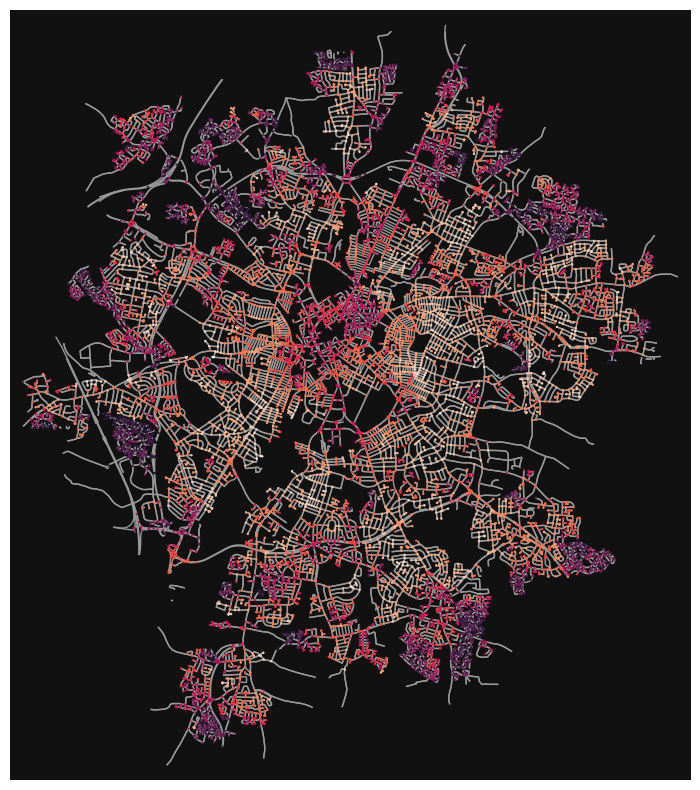

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [10]:
ox.plot_graph(leicester_osmnx_graph_prj, node_color=[
    leicester_osmnx_graph_prj.nodes[node]["EMB000"] for node in leicester_osmnx_graph_prj.nodes],
    node_size=3,
    figsize=(10, 10))

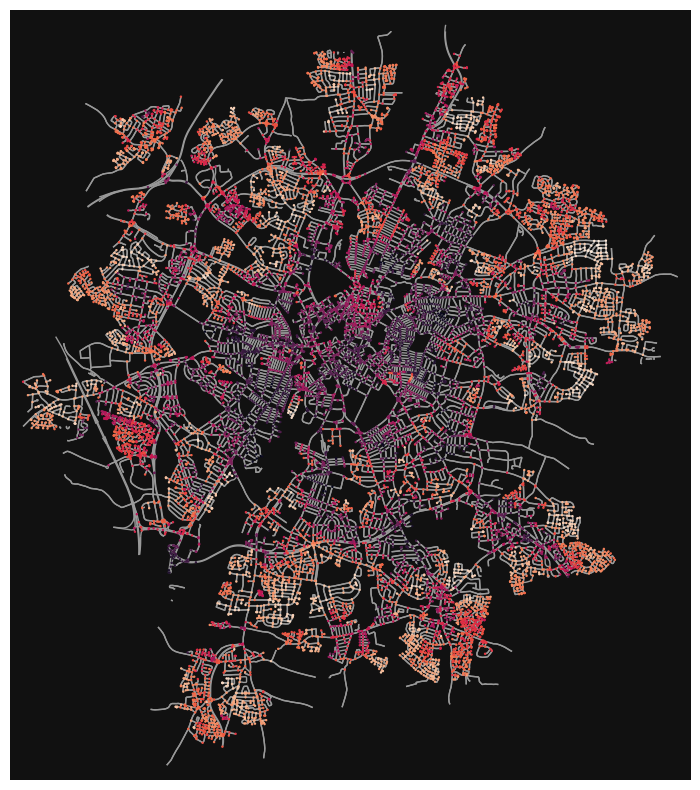

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [11]:
ox.plot_graph(leicester_osmnx_graph_prj, node_color=[
    leicester_osmnx_graph_prj.nodes[node]["EMB001"] for node in leicester_osmnx_graph_prj.nodes],
    node_size=3,
    figsize=(10, 10))

## Correlations with basic stats

Checking correlations between EMB000 and EMB001 and all the basic statistics from OSMnx. No clear correlation found.

In [12]:
leicester_pairplot_df = pd.merge(
        leicester_emb_df[["osmnx_node_id", "EMB000", "EMB001"]],
        leicester_osmnx_basic_stats[["osmnx_node_id",
            "n", "m", "k_avg", "edge_length_total", "edge_length_avg",
            "streets_per_node_avg", "intersection_count", "street_length_total",
            "street_segment_count", "street_length_avg", "circuity_avg"]],
        on="osmnx_node_id"
    ).drop(columns=["osmnx_node_id"])

In [13]:
print(leicester_pairplot_df.corr(method="kendall"))

                        EMB000    EMB001         n         m     k_avg   
EMB000                1.000000 -0.170566 -0.138311 -0.068330  0.376507  \
EMB001               -0.170566  1.000000 -0.226253 -0.212787  0.036726   
n                    -0.138311 -0.226253  1.000000  0.891733  0.013712   
m                    -0.068330 -0.212787  0.891733  1.000000  0.132379   
k_avg                 0.376507  0.036726  0.013712  0.132379  1.000000   
edge_length_total     0.208221 -0.245809  0.589867  0.665304  0.305397   
edge_length_avg       0.579544 -0.021938 -0.296360 -0.234006  0.292995   
streets_per_node_avg  0.430593 -0.420593  0.097850  0.117131  0.151434   
intersection_count   -0.019241 -0.302492  0.826980  0.810128  0.057609   
street_length_total   0.190095 -0.315328  0.617244  0.656864  0.211502   
street_segment_count -0.069979 -0.284915  0.902224  0.878092  0.040801   
street_length_avg     0.588756 -0.014573 -0.292572 -0.224905  0.323991   
circuity_avg         -0.065721  0.2250

## Extreme values

Checking the ego-network of the nodes with the most extreme values in each direction (min and max) for both UMAP0 and UMAP1

In [14]:
leicester_emb_df[leicester_emb_df["osmnx_node_id"] == 192297276]

,osmnx_node_id,EMB000,EMB001
2657,192297276,0.899455,0.883451


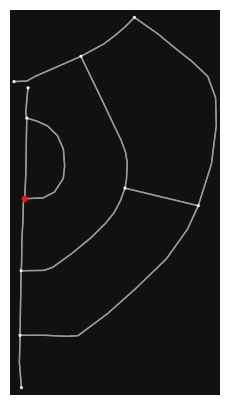

(<Figure size 500x500 with 1 Axes>, <Axes: >)

In [15]:
ego_192297276 = nx.generators.ego_graph(
    leicester_osmnx_graph, 192297276,
    radius=max_distance, undirected=True, distance="length")
ego_192297276_prj = ox.project_graph(ego_192297276)
ox.plot_graph(
    ego_192297276_prj,
    node_size=[20 if node == 192297276 else 5 for node in ego_192297276_prj.nodes],
    node_color=["#e41a1c" if node == 192297276 else "#ffffff" for node in ego_192297276_prj.nodes],
    figsize=(5, 5)
)

## Explore patterns

In [16]:
leicester_emb_patters_df = leicester_emb_df.copy()

In [17]:
# from sklearn.cluster import DBSCAN
# leicester_emb_df_clust = leicester_emb_df[["EMB000", "EMB001"]].dropna()
# clust = DBSCAN(eps=0.015, min_samples=100)
# leicester_emb_patters_df["clust"] = clust.fit_predict(leicester_emb_df_clust)
# leicester_emb_patters_df["clust"] = leicester_emb_patters_df["clust"].apply(lambda x: str(x) if x>-1 else None)
# leicester_emb_patters_df.head()

In [18]:
# leicester_emb_df.head()
# fig = px.scatter(
#     leicester_emb_patters_df,
#     x="EMB000",
#     y="EMB001",
#     color="clust",
#     hover_data=['osmnx_node_id'],
#     width=800, height=800
# )
# fig.update_layout({"plot_bgcolor": "#ffffff"}, width=800, height=800)
# fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
# fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
# fig.show()

In [19]:
def bivariate_colour(x, limits):
    if x[0] is None or x[1] is None:
        return None
    else:
        if x[0] <= limits[0, 0]:
            if x[1] <= limits[1, 0]:
                # return "#e8e8e8"
                return "#e8e8e8"
            elif x[1] <= limits[1, 1]:
                # return "#cbb8d7"
                return "#e4acac"
            else:
                # return "#9972af"
                return "#c85a5a"
        if x[0] <= limits[0, 1]:
            if x[1] <= limits[1, 0]:
                # return "#e4d9ac"
                return "#b0d5df"
            elif x[1] <= limits[1, 1]:
                # return "#c8ada0"
                return "#ad9ea5"
            else:
                # return "#976b82"
                return "#985356"
        else:
            if x[1] <= limits[1, 0]:
                # return "#c8b35a"
                return "#64acbe"
            elif x[1] <= limits[1, 1]:
                # return "#af8e53"
                return "#627f8c"
            else:
                # return "#804d36"
                return "#574249"

leicester_emb_quantiles = leicester_emb_df[["EMB000", "EMB001"]].quantile([1/3, 2/3]).values.transpose()
leicester_emb_patters_df["bivariate_colour"] = leicester_emb_patters_df.apply(
    lambda x: bivariate_colour([x["EMB000"], x["EMB001"]], leicester_emb_quantiles), axis=1
)
leicester_emb_patters_df.head()

,osmnx_node_id,EMB000,EMB001,bivariate_colour
0,337976,-0.214178,0.073930,#e4acac
1,337979,-0.112598,-0.131984,#e8e8e8
2,337983,-0.074082,0.194142,#e4acac
3,337985,-0.095356,0.193887,#e4acac
4,337986,-0.074082,0.194142,#e4acac


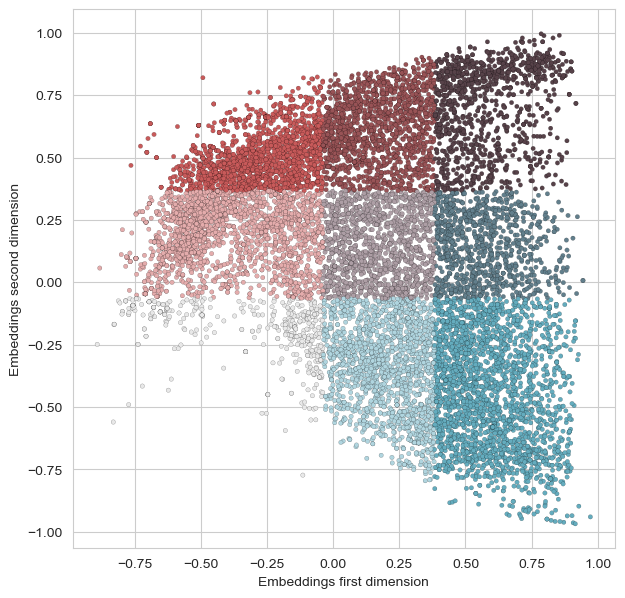

In [20]:
plt.figure(figsize=(7,7))
ax = plt.axes()
ax.set_facecolor("white")
plt.scatter(
    x=leicester_emb_patters_df.EMB000,
    y=leicester_emb_patters_df.EMB001,
    c=leicester_emb_patters_df.bivariate_colour,
    s=10, edgecolors='black', linewidth=0.1)
plt.xlabel("Embeddings first dimension")
plt.ylabel("Embeddings second dimension")
plt.show()

In [21]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=leicester_emb_patters_df.EMB000,
    y=leicester_emb_patters_df.EMB001,
    mode='markers',
    marker=dict(color=leicester_emb_patters_df.bivariate_colour)
))
fig.update_layout({"plot_bgcolor": "#ffffff"}, width=800, height=800)
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='#cccccc', zeroline=True, zerolinewidth=1, zerolinecolor='#cccccc')
fig.show()

In [22]:
leicester_osmnx_bivariate = leicester_osmnx_graph_prj.copy()

for node in leicester_osmnx_bivariate.nodes:
    node_bivariate_colour = leicester_emb_patters_df.loc[leicester_emb_patters_df["osmnx_node_id"] == node]
    if node_bivariate_colour.empty:
        leicester_osmnx_bivariate.nodes[node]["bivariate_colour"] = "#000000"
        leicester_osmnx_bivariate.nodes[node]["node_size"] = 1
    else:
        leicester_osmnx_bivariate.nodes[node]["bivariate_colour"] = node_bivariate_colour["bivariate_colour"].values[0]
        leicester_osmnx_bivariate.nodes[node]["node_size"] = 7

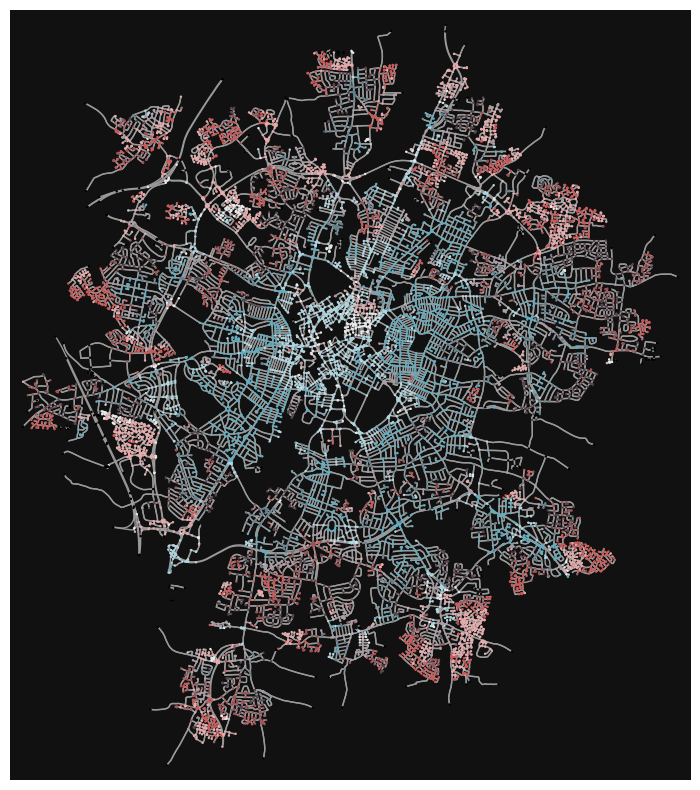

(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

In [23]:
ox.plot_graph(
    leicester_osmnx_bivariate,
    node_color=[leicester_osmnx_bivariate.nodes[node]["bivariate_colour"] for node in leicester_osmnx_bivariate.nodes],
    node_size=3,
    figsize=(10, 10))

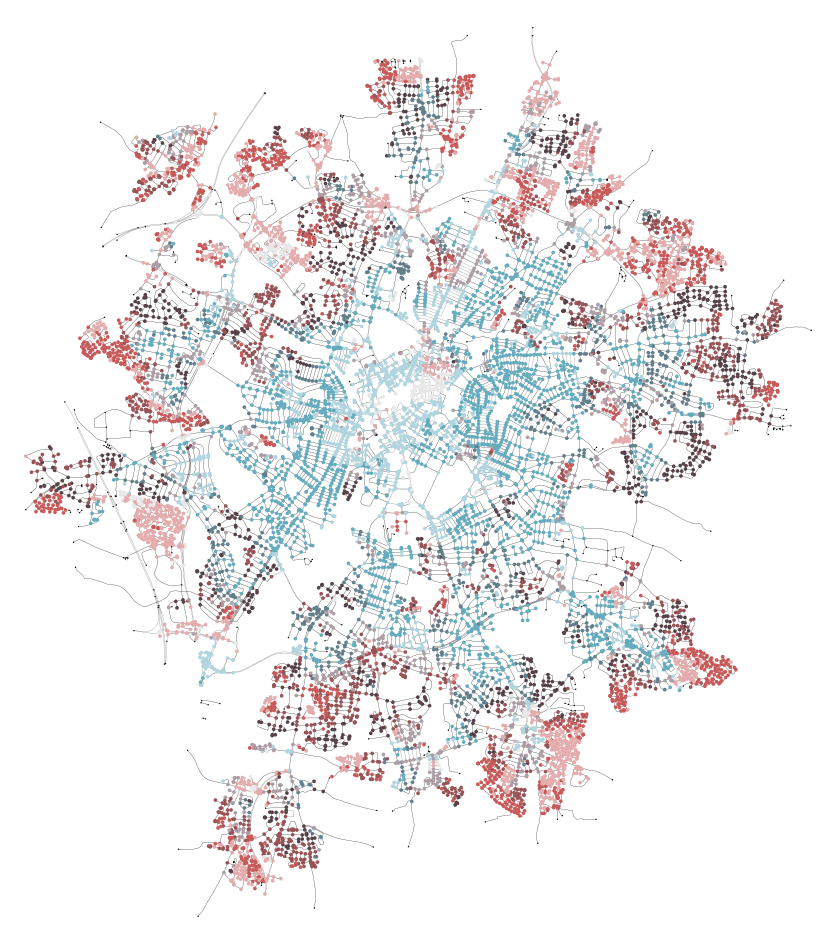

(<Figure size 1200x1200 with 1 Axes>, <Axes: >)

In [24]:
ox.plot_graph(
    leicester_osmnx_bivariate,
    node_color=[leicester_osmnx_bivariate.nodes[node]["bivariate_colour"] for node in leicester_osmnx_bivariate.nodes],
    node_size=[leicester_osmnx_bivariate.nodes[node]["node_size"] for node in leicester_osmnx_bivariate.nodes],
    bgcolor="#ffffff", edge_color="#000000", edge_linewidth=0.1,
    figsize=(12, 12))

In [25]:
import geopandas as gpd
leicester_gdf = gpd.GeoDataFrame(
    leicester_osmnx_graph_prj_df,
    geometry=gpd.points_from_xy(
        leicester_osmnx_graph_prj_df.lon,
        leicester_osmnx_graph_prj_df.lat
    ),
    crs="EPSG:4326"
).merge(leicester_emb_patters_df, on='osmnx_node_id', how='left').merge(leicester_osmnx_basic_stats, on='osmnx_node_id', how='left')
leicester_gdf.head()

,y,x,street_count,elevation,elevation_aster,elevation_srtm,lon,lat,osmnx_node_id,ref,...,edge_length_avg,streets_per_node_avg,streets_per_node_counts,streets_per_node_proportions,intersection_count,street_length_total,street_segment_count,street_length_avg,circuity_avg,self_loop_proportion
0,5.829804e+06,622151.977595,3,72.0,35,72,-1.196195,52.604506,194739,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5.829991e+06,622098.041002,3,72.0,45,72,-1.196922,52.606196,1551014281,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5.828827e+06,622259.813792,2,79.0,57,79,-1.194965,52.595696,326312,21,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5.830107e+06,622077.742140,3,79.0,43,79,-1.197179,52.607245,326320,21,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5.829673e+06,622220.645785,3,74.0,35,74,-1.195230,52.603314,2627867454,NaN,...,160.60625,3.0,"{0: 0, 1: 0, 2: 0, 3: 11}","{0: 0.0, 1: 0.0, 2: 0.0, 3: 1.0}",11.0,1927.275,12.0,160.60625,1.021342,0.0


In [26]:
# leicester_gdf.dropna(subset=['clust']).explore(
#     column="clust",
#     marker_kwds={"radius": 7}, style_kwds={"stroke": False},
#     tiles="Stamen Toner"
# )

In [27]:
leicester_gdf[leicester_gdf["bivariate_colour"]!="#000000"].dropna(subset=["EMB000"]).explore(
    # column="EMB000", cmap="YlOrRd",
    color="bivariate_colour",
    marker_kwds={"radius": 7}, style_kwds={"stroke": False},
    legend=True,
    tiles="Stamen Toner"
)